# Fine tune the Inception V1 network using UC Merced image set

### Prerequisites
  1. UCM_Creating_TF_Record_Datasets notebook to create a user local copy of training data from the system image files.

In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import math
import os
import random
import sys
import tensorflow as tf


In [17]:
sys.path.append('./CGI-TensorFlow/slim/')

from datasets import dataset_utils


slim = tf.contrib.slim

_FILE_PATTERN = 'UCMerced_%s_*.tfrecord'

SPLITS_TO_SIZES = {'train': 2400, 'validation': 600}

_NUM_CLASSES = 3

_ITEMS_TO_DESCRIPTIONS = {
    'image': 'A color image of varying size.',
    'label': 'A single integer between 0 and 21',
}

# The number of shards per dataset split.
_NUM_SHARDS = 5

In [18]:
def get_split(split_name, dataset_dir, file_pattern=None, reader=None):
  """Gets a dataset tuple with instructions for reading flowers.

  Args:
    split_name: A train/validation split name.
    dataset_dir: The base directory of the dataset sources.
    file_pattern: The file pattern to use when matching the dataset sources.
      It is assumed that the pattern contains a '%s' string so that the split
      name can be inserted.
    reader: The TensorFlow reader type.

  Returns:
    A `Dataset` namedtuple.

  Raises:
    ValueError: if `split_name` is not a valid train/validation split.
  """
  if split_name not in SPLITS_TO_SIZES:
    raise ValueError('split name %s was not recognized.' % split_name)

  if not file_pattern:
    file_pattern = _FILE_PATTERN
  file_pattern = os.path.join(dataset_dir, file_pattern % split_name)

  # Allowing None in the signature so that dataset_factory can use the default.
  if reader is None:
    reader = tf.TFRecordReader

  keys_to_features = {
      'image/encoded': tf.FixedLenFeature((), tf.string, default_value=''),
      'image/format': tf.FixedLenFeature((), tf.string, default_value=b'png'),
      'image/class/label': tf.FixedLenFeature(
          [], tf.int64, default_value=tf.zeros([], dtype=tf.int64)),
  }

  items_to_handlers = {
      'image': slim.tfexample_decoder.Image(),
      'label': slim.tfexample_decoder.Tensor('image/class/label'),
  }

  decoder = slim.tfexample_decoder.TFExampleDecoder(
      keys_to_features, items_to_handlers)

  labels_to_names = None
  if dataset_utils.has_labels(dataset_dir):
    labels_to_names = dataset_utils.read_label_file(dataset_dir)

  return slim.dataset.Dataset(
      data_sources=file_pattern,
      reader=reader,
      decoder=decoder,
      num_samples=SPLITS_TO_SIZES[split_name],
      items_to_descriptions=_ITEMS_TO_DESCRIPTIONS,
      num_classes=_NUM_CLASSES,
      labels_to_names=labels_to_names)

print("Function: get_split(...) is ready")

Function: get_split(...) is ready


In [19]:
# Note that this may take several minutes.

import os

from nets import inception
from preprocessing import inception_preprocessing

slim = tf.contrib.slim
image_size = inception.inception_v1.default_image_size

# Local TF Record data location
dataset_dir = '/dsa/home/jamgtn/experimental/data/refugee_camp_TF_data'

# Folds go from A - E
fold = 'A'

# Checkpoints Folder:
checkpoints_dir = './model_checkpoints'

In [20]:
def get_init_fn():
    """Returns a function run by the chief worker to warm-start the training."""
    checkpoint_exclude_scopes=["InceptionV1/Logits", "InceptionV1/AuxLogits"]
    
    exclusions = [scope.strip() for scope in checkpoint_exclude_scopes]

    variables_to_restore = []
    for var in slim.get_model_variables():
        excluded = False
        for exclusion in exclusions:
            if var.op.name.startswith(exclusion):
                excluded = True
                break
        if not excluded:
            variables_to_restore.append(var)

    return slim.assign_from_checkpoint_fn(
      os.path.join(checkpoints_dir, 'inception_v1.ckpt'),
      variables_to_restore)

print("Function: get_init_fn() is ready")

Function: get_init_fn() is ready


In [21]:
from preprocessing import inception_preprocessing

def load_batch(dataset, batch_size=600, height=299, width=299, is_training=False):
    """Loads a single batch of data.
    
    Args:
      dataset: The dataset to load.
      batch_size: The number of images in the batch.
      height: The size of each image after preprocessing.
      width: The size of each image after preprocessing.
      is_training: Whether or not we're currently training or evaluating.
    
    Returns:
      images: A Tensor of size [batch_size, height, width, 3], image samples that have been preprocessed.
      images_raw: A Tensor of size [batch_size, height, width, 3], image samples that can be used for visualization.
      labels: A Tensor of size [batch_size], whose values range between 0 and dataset.num_classes.
    """
    # change shuffle to true for the first run and to false on evaluation run. 
    data_provider = slim.dataset_data_provider.DatasetDataProvider(
        dataset, shuffle=False, common_queue_capacity=600,
        common_queue_min=8)
    image_raw, label = data_provider.get(['image', 'label'])
    
    # Preprocess image for usage by Inception.
    image = inception_preprocessing.preprocess_image(image_raw, height, width, is_training=is_training)
    
    # Preprocess the image for display purposes.
    image_raw = tf.expand_dims(image_raw, 0)
    image_raw = tf.image.resize_images(image_raw, [height, width])
    image_raw = tf.squeeze(image_raw)

    # Batch it up.
    images, images_raw, labels = tf.train.batch(
          [image, image_raw, label],
          batch_size=batch_size,
          num_threads=1,
          capacity=2 * batch_size)
    
    return images, images_raw, labels


print("Function: load_batch(...) is ready")

Function: load_batch(...) is ready


#  Create a TensorFlow graph context and training the model.

In [ ]:
train_dir = './inception_finetuned/'

with tf.Graph().as_default():
    tf.logging.set_verbosity(tf.logging.INFO)
    
    dataset = get_split('train', dataset_dir)
    images, _, labels = load_batch(dataset, height=image_size, width=image_size)
    
    # Create the model, use the default arg scope to configure the batch norm parameters.
    with slim.arg_scope(inception.inception_v1_arg_scope()):
        logits, _ = inception.inception_v1(images, num_classes=dataset.num_classes, is_training=True) 
        
    # Specify the loss function:
    one_hot_labels = slim.one_hot_encoding(labels, dataset.num_classes)
    slim.losses.softmax_cross_entropy(logits, one_hot_labels)
    total_loss = slim.losses.get_total_loss()

    # Create some summaries to visualize the training process:
    tf.summary.scalar('losses/Total Loss', total_loss)
  
    # Specify the optimizer and create the train op:
    optimizer = tf.train.AdamOptimizer(learning_rate=0.01)
    train_op = slim.learning.create_train_op(total_loss, optimizer)
    
    # Run the training:
    final_loss = slim.learning.train(
        train_op,
        logdir=train_dir,
        init_fn=get_init_fn(),
        number_of_steps=200)
        
  
print('Finished training. Last batch loss %f' % final_loss)

Instructions for updating:
Use tf.losses.softmax_cross_entropy instead. Note that the order of the logits and labels arguments has been changed.
Instructions for updating:
Use tf.losses.compute_weighted_loss instead.
Instructions for updating:
Use tf.losses.add_loss instead.
Instructions for updating:
Use tf.losses.get_total_loss instead.
Instructions for updating:
Use tf.losses.get_losses instead.
Instructions for updating:
Use tf.losses.get_regularization_losses instead.
INFO:tensorflow:Summary name losses/Total Loss is illegal; using losses/Total_Loss instead.
INFO:tensorflow:Restoring parameters from ./inception_finetuned/model.ckpt-212
INFO:tensorflow:Starting Session.
INFO:tensorflow:Saving checkpoint to path ./inception_finetuned/model.ckpt
INFO:tensorflow:Starting Queues.
INFO:tensorflow:global_step/sec: 0
INFO:tensorflow:Recording summary at step 212.
INFO:tensorflow:global step 213: loss = 0.2899 (113.860 sec/step)
INFO:tensorflow:Stopping Training.
INFO:tensorflow:Finished t

# Conduct validation Testing on the trained model

Instructions for updating:
Use `tf.local_variables_initializer` instead.
INFO:tensorflow:Restoring parameters from ./inception_finetuned/model.ckpt-213


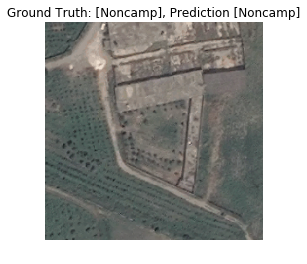

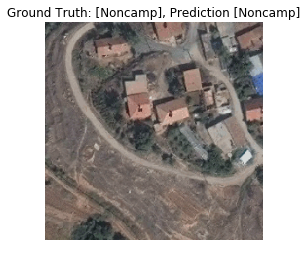

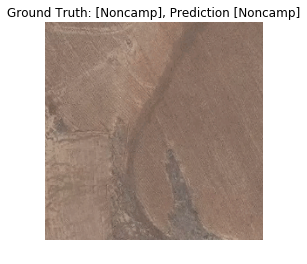

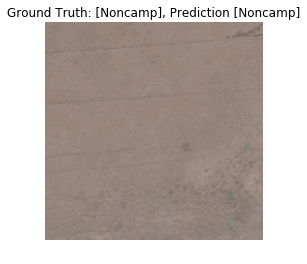

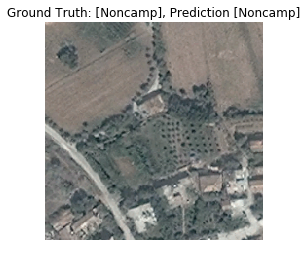

...

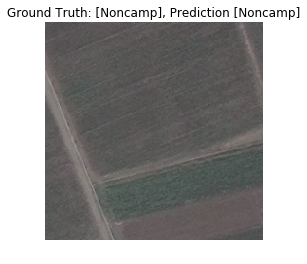

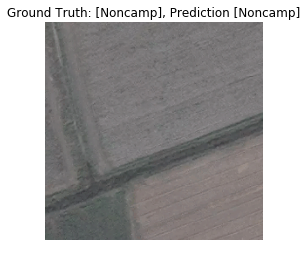

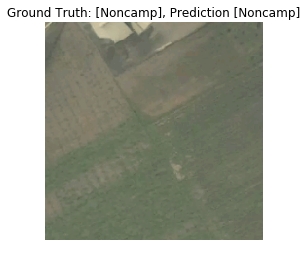

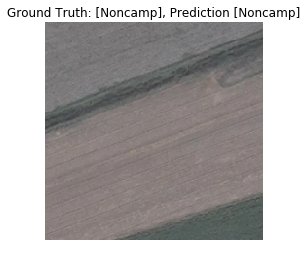

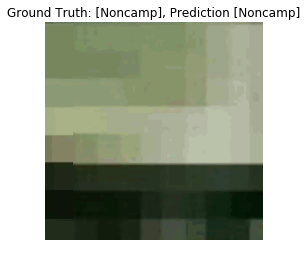

In [ ]:
import numpy as np
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
import math

image_size = inception.inception_v1.default_image_size
batch_size = 600

with tf.Graph().as_default():
    tf.logging.set_verbosity(tf.logging.INFO)
    
    dataset = get_split('train', dataset_dir)
    images, images_raw, labels = load_batch(dataset, height=image_size, width=image_size)
    
    # Create the model, use the default arg scope to configure the batch norm parameters.
    with slim.arg_scope(inception.inception_v1_arg_scope()):
        logits, _ = inception.inception_v1(images, num_classes=dataset.num_classes, is_training=True)

    probabilities = tf.nn.softmax(logits)
    
    checkpoint_path = tf.train.latest_checkpoint(train_dir)
    init_fn = slim.assign_from_checkpoint_fn(
      checkpoint_path,
      slim.get_variables_to_restore())
    
    with tf.Session() as sess:
        with slim.queues.QueueRunners(sess):
            sess.run(tf.initialize_local_variables())
            init_fn(sess)
            np_probabilities, np_images_raw, np_labels = sess.run([probabilities, images_raw, labels])
    
            for i in range(batch_size): 
                image = np_images_raw[i, :, :, :]
                true_label = np_labels[i]
                predicted_label = np.argmax(np_probabilities[i, :])
                predicted_name = dataset.labels_to_names[predicted_label]
                true_name = dataset.labels_to_names[true_label]
                
                plt.figure()
                plt.imshow(image.astype(np.uint8))
                plt.title('Ground Truth: [%s], Prediction [%s]' % (true_name, predicted_name))
                plt.axis('off')
                plt.show()

## Test Model and Evaluate 

In [9]:
###############################################################################

true_label = []
predicted_label = []


image_size = inception.inception_v1.default_image_size
batch_size = 600

with tf.Graph().as_default():
    tf.logging.set_verbosity(tf.logging.INFO)
    
    dataset = get_split('validation', dataset_dir)
    images, images_raw, labels = load_batch(dataset, height=image_size, width=image_size)
    
    # Create the model, use the default arg scope to configure the batch norm parameters.
    with slim.arg_scope(inception.inception_v1_arg_scope()):
        logits, _ = inception.inception_v1(images, num_classes=dataset.num_classes, is_training=False)

    probabilities = tf.nn.softmax(logits)
    
    checkpoint_path = tf.train.latest_checkpoint(train_dir)
    init_fn = slim.assign_from_checkpoint_fn(
      checkpoint_path,
      slim.get_variables_to_restore())
    
    with tf.Session() as sess:
        with slim.queues.QueueRunners(sess):
            sess.run(tf.initialize_local_variables())
            init_fn(sess)
            np_probabilities, np_images_raw, np_labels = sess.run([probabilities, images_raw, labels])
    
            for i in range(batch_size): 
                #print(i)
                true_label.append ( np_labels[i])
                predicted_label.append ( np.argmax(np_probabilities[i, :]))
                #confusion = tf.confusion_matrix(labels=true_label, predictions=predicted_label, num_classes=num_classes)
                #expected = dataset.labels_to_names[true_label] # Append true_label to expected[] 
                #predicted = dataset.labels_to_names[predicted_label] # Append predicted_label to predicted[]


                #plt.figure()
                #plt.imshow(image.astype(np.uint8))
                #plt.title('expected: [%s], predicted [%s]' % (expected, predicted))
                #plt.axis('off')
                #plt.show()
                
        print(predicted_label)
        print(true_label)


Instructions for updating:
Use `tf.local_variables_initializer` instead.
INFO:tensorflow:Restoring parameters from ./inception_finetuned/model.ckpt-212
[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]


In [11]:
from sklearn.metrics import confusion_matrix

conf = confusion_matrix(true_label, predicted_label)
print(conf)

[[ 0  3]
 [ 0 97]]


In [14]:
conf[0,]

array([0, 3])

In [15]:
# (TP+TN)/total
Accuracy = (97+0)/100
print(Accuracy)

0.97


In [16]:
# (FP+FN)/total 
Misclassification_Rate = (3+0)/100
print(Misclassification_Rate)

0.03
